In [1]:
import os
import pandas as pd
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from tensorflow.keras import models, optimizers
from keras.callbacks import EarlyStopping, ReduceLROnPlateau
from datetime import datetime as dt
from sklearn.model_selection import KFold
import import_ipynb
from Model_dev import compress_to_2d, get_model, LSTM_model, Attention, C_LSTM, data_handling, model_development, rmse, draw_graph
import copy

importing Jupyter notebook from Model_dev.ipynb


In [2]:
country = 'Brazil'
datadir = os.path.join(os.getcwd(), "Data")
modeldir = os.path.join(os.getcwd(), "Models")
logdir = os.path.join(os.getcwd(), "Log")
filename = "Full_{}.csv".format(country)
filepath = os.path.join(datadir, filename)
social_media = ['like_index','retweet_index']
covid_cases = ['ConfirmedCases', 'ConfirmedDeaths', 'Daily_cases']
general_info = ['CountryCode_x', 'CountryName_x', 'Jurisdiction', 'Date']
num_variable = ['E3_Fiscal measures', 'E4_International support', 'H5_Investment in vaccines', 'H4_Emergency investment in healthcare']
required_days = 14
pred_days = 7

In [3]:
from numpy.random import seed
seed(1234)
from tensorflow.random import set_seed
set_seed(1234)

In [4]:
if not os.path.isdir(modeldir):
    os.mkdir(modeldir)
if not os.path.isdir(logdir):
    os.mkdir(logdir)
if not os.path.isdir(datadir):
    os.mkdir(datadir)
if not os.path.isdir(os.path.join(logdir, country)):
    os.mkdir(os.path.join(logdir, country))

In [5]:
df = pd.read_csv(filepath, index_col=0)
df.set_index('Date', inplace=True)

policy = []
columns = df.columns
for column in columns:
    if not any(column in _list for _list in [social_media, general_info, covid_cases]):
        policy.append(column)
categorical_variable = list(set(policy) - set(num_variable))
df[categorical_variable] = df[categorical_variable].astype("category")

##### Reshape and MinMaxScale input #####
(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
##### Model Development #####
Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm (LSTM)                  (None, 32)                7296      
_________________________________________________________________
dense (Dense)                (None, 32)                1056      
_________________________________________________________________
dense_1 (Dense)              (None, 7)                 231       
_________________________________________________________________
reshape (Reshape)            (None, 7, 1)              0         
Total params: 8,583
Trainable params: 8,583
Non-trainable params: 0
_________________________________________________________________
Model: "model"
__________________________________________________________________________________________________
Layer (type)    

INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-04Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-04Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-04C-LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-04C-LSTM\assets


##### Log completed #####


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

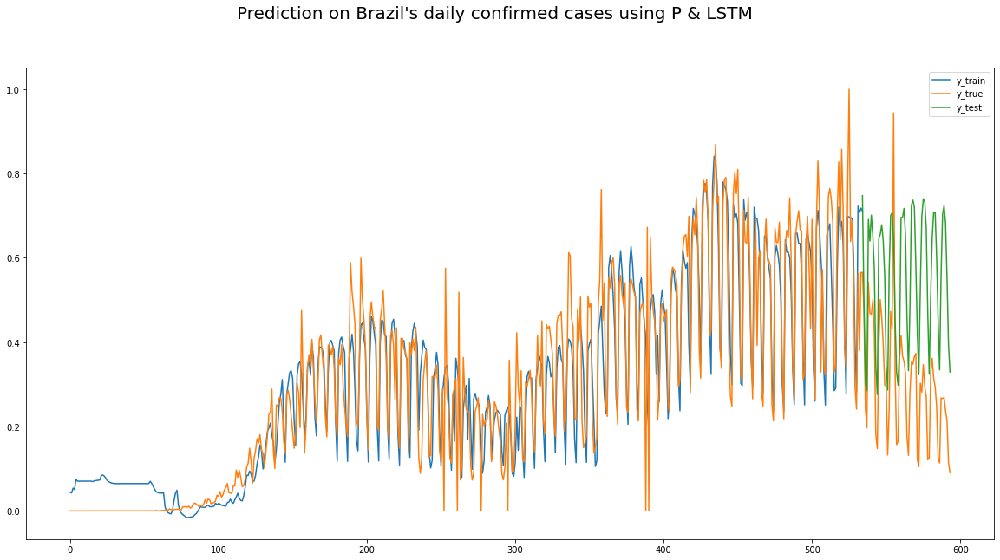

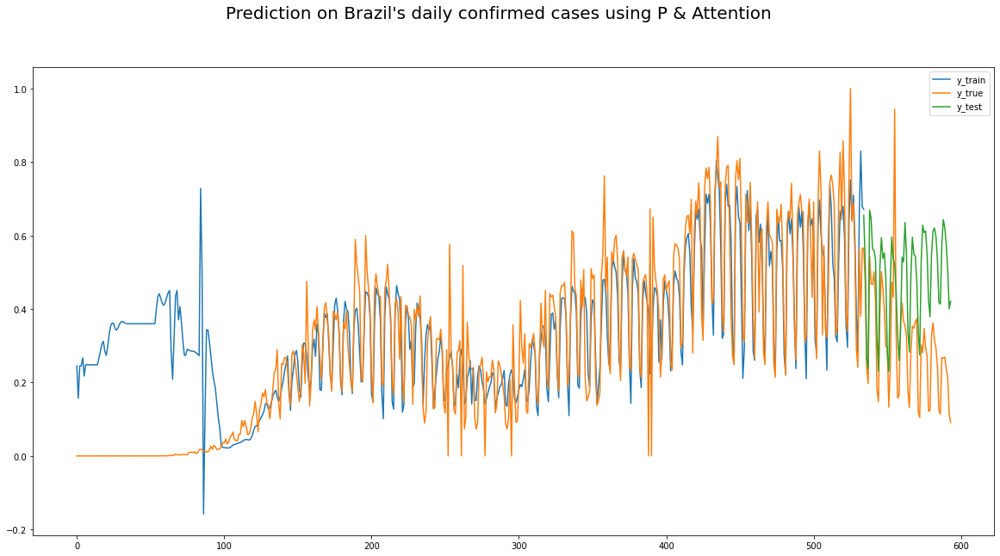

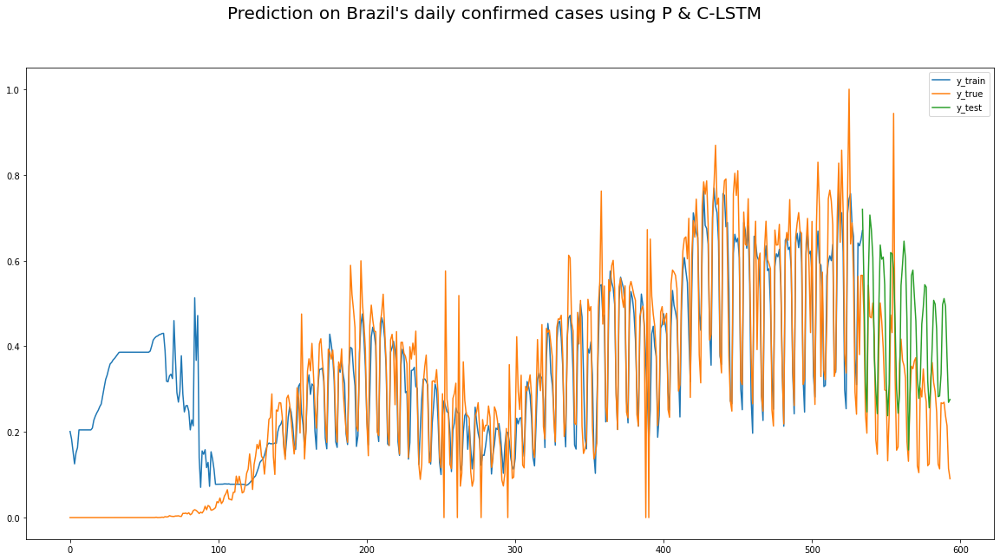

In [6]:
features = policy
x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
model_development(x_train, x_test, y_train, y_test, "P", country, modeldir, logdir, required_days, pred_days)

##### Reshape and MinMaxScale input #####
(529, 14, 26) (529, 7, 1) (59, 14, 26) (59, 7, 1)
##### Model Development #####
Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_5 (LSTM)                (None, 32)                7552      
_________________________________________________________________
dense_6 (Dense)              (None, 32)                1056      
_________________________________________________________________
dense_7 (Dense)              (None, 7)                 231       
_________________________________________________________________
reshape_3 (Reshape)          (None, 7, 1)              0         
Total params: 8,839
Trainable params: 8,839
Non-trainable params: 0
_________________________________________________________________
Model: "model_1"
__________________________________________________________________________________________________
Layer (type)

INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-23LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-23Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-23Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-23C-LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-23C-LSTM\assets


##### Log completed #####


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

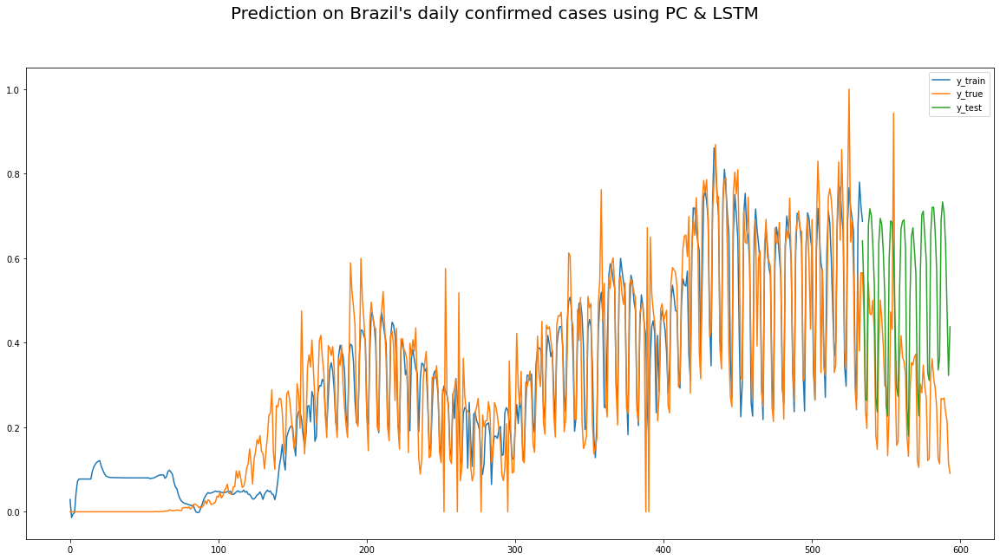

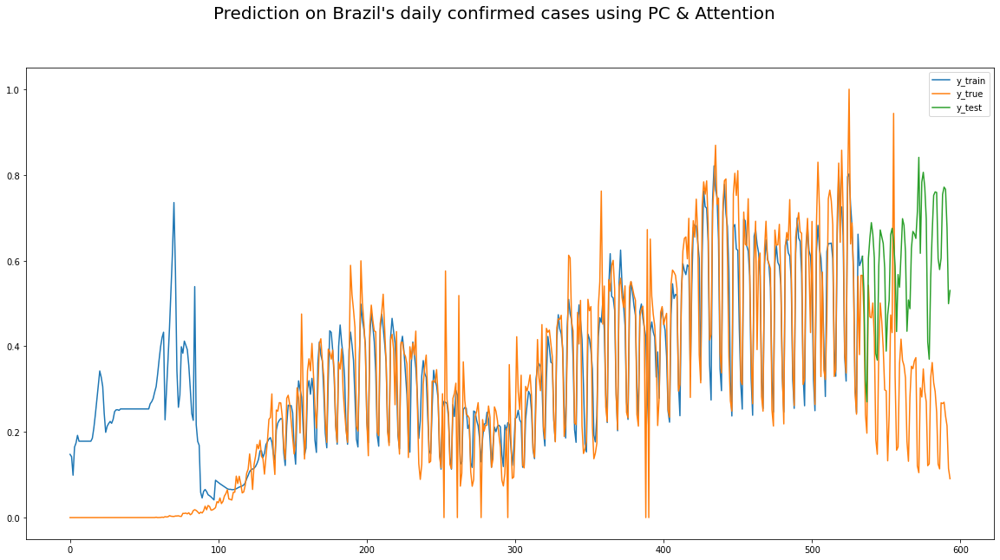

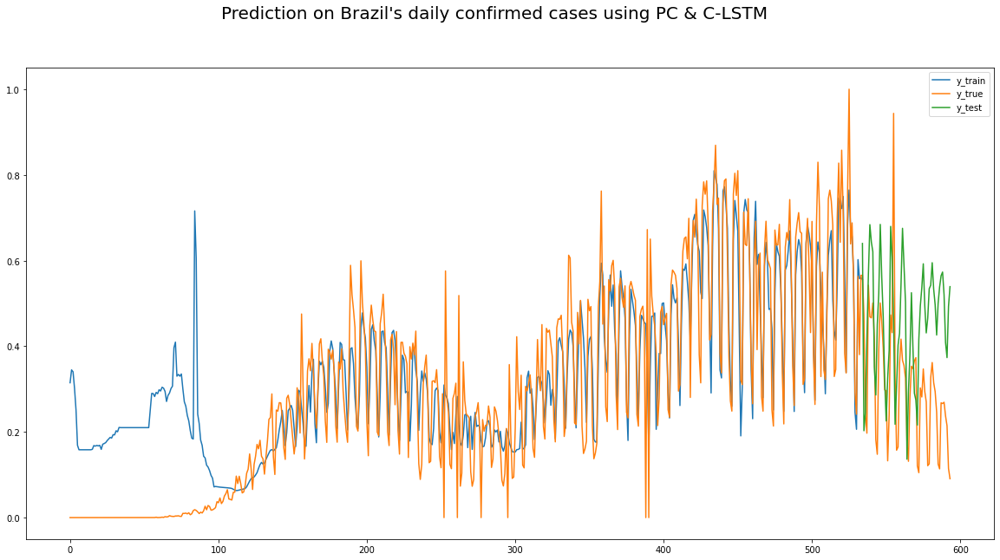

In [7]:
features = policy + covid_cases
x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
model_development(x_train, x_test, y_train, y_test, "PC", country, modeldir, logdir, required_days, pred_days)

##### Reshape and MinMaxScale input #####
(529, 14, 28) (529, 7, 1) (59, 14, 28) (59, 7, 1)
##### Model Development #####
Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_10 (LSTM)               (None, 32)                7808      
_________________________________________________________________
dense_12 (Dense)             (None, 32)                1056      
_________________________________________________________________
dense_13 (Dense)             (None, 7)                 231       
_________________________________________________________________
reshape_6 (Reshape)          (None, 7, 1)              0         
Total params: 9,095
Trainable params: 9,095
Non-trainable params: 0
_________________________________________________________________
Model: "model_2"
__________________________________________________________________________________________________
Layer (type)

INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-44LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-44Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-44Attention\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-44C-LSTM\assets


INFO:tensorflow:Assets written to: C:\Users\wasin\Downloads\Work\PG(HKU)\FYP\Program_Data\Models\20211027 18-44C-LSTM\assets


##### Log completed #####


<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

<Figure size 1440x720 with 0 Axes>

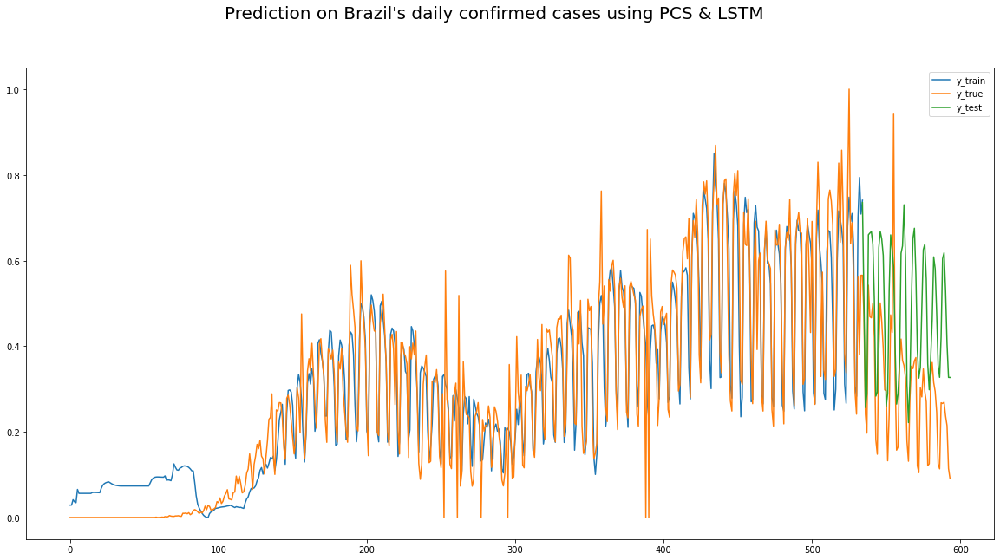

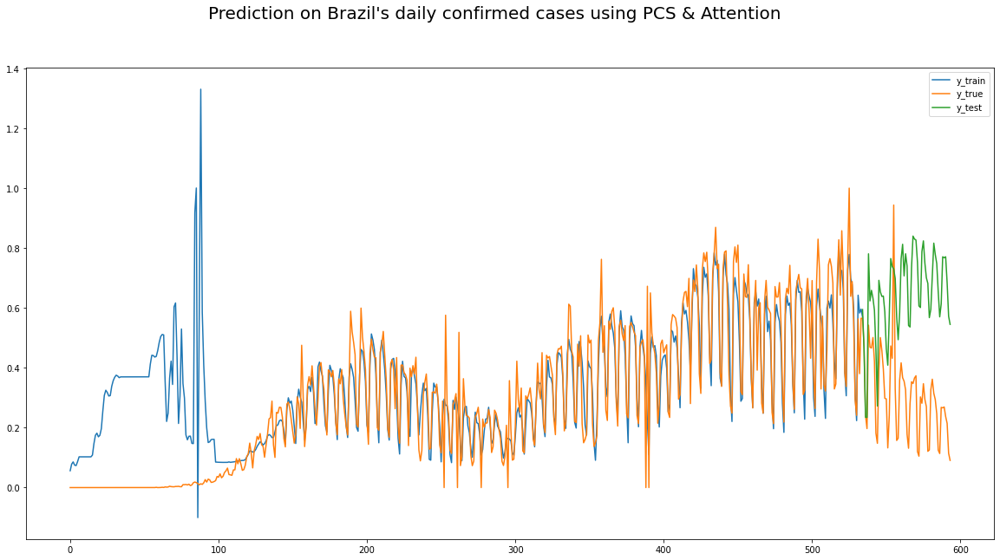

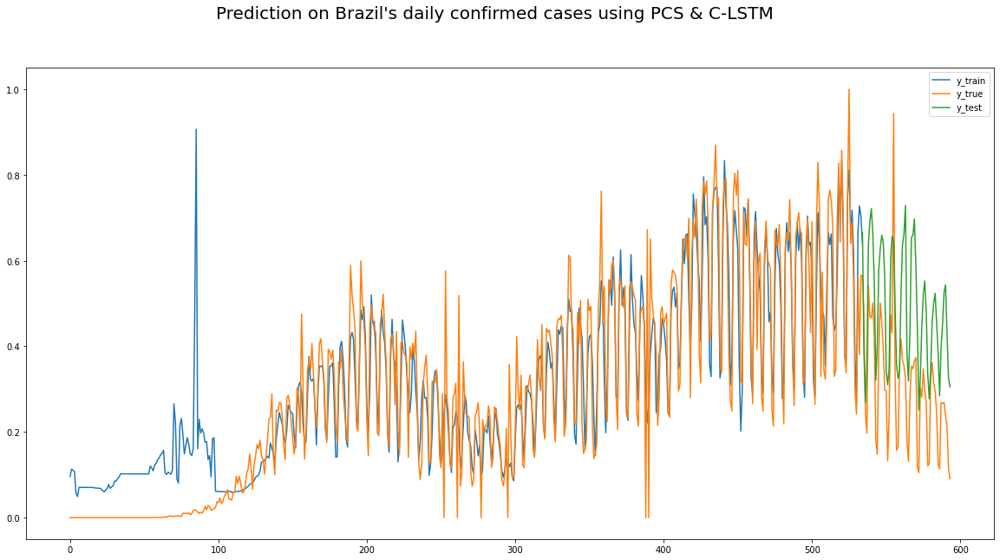

In [8]:
features = policy + covid_cases + social_media
x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
model_development(x_train, x_test, y_train, y_test, "PCS", country, modeldir, logdir, required_days, pred_days)

In [9]:
### Best model for the country
log_file = os.path.join(logdir,"Models.csv")
best_result = get_model(log_file, country)

features_used = best_result['Features'].values[0]
algo = best_result['Algorithm'].values[0]
best_model_filepath = best_result['Model_path'].values[0]
best_model = models.load_model(best_model_filepath, custom_objects={'rmse':rmse})
config = best_model.get_config()

if features_used == "P":
    features = policy
elif features_used == "PC":
    features = policy + covid_cases
else:
    features = policy + covid_cases + social_media

x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days)
y_pred_train = compress_to_2d(best_model.predict(x_train))
y_pred_test = compress_to_2d(best_model.predict(x_test))
y_true_train = compress_to_2d(y_train)
y_true_test = compress_to_2d(y_test)

mse = tf.keras.losses.MeanSquaredError()
loss = mse(y_true_train, y_pred_train).numpy()
val_loss = mse(y_true_test, y_pred_test).numpy()

##### Reshape and MinMaxScale input #####
(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)


In [10]:
early_stopping = EarlyStopping(monitor='val_loss', min_delta=0.01, patience=100, mode='min')
reduce_lr = ReduceLROnPlateau(monitor='val_loss', patience=10, factor=0.4, min=0.00001)
opt = optimizers.Adam(learning_rate=0.01)

##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C1_School closing #####
Changes in loss: -0.004867212846875191
Changes in Validation loss: -0.0028489967808127403
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.006459575146436691
Changes in Validation loss: -0.0009681116789579391
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.001073002815246582
Changes in Validation loss: -0.00011310633271932602
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.015296421945095062
Changes in Validation loss: 0.006574069149792194
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.0002976711839437485
Changes in Validation loss: 0.0003193644806742668
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0015322566032409668
Changes in Validation loss: 0.0003858031705021858
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.005686268210411072
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.0024503543972969055
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### E1_Income support #####
Changes in loss: 0.002941656857728958
Changes in Validation loss: -0.0026542730629444122
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.006509676575660706
Changes in Validation loss: -0.0033275652676820755
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0003322772681713104
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.005582883954048157
Changes in Validation loss: 6.99162483215332e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.012196119874715805
Changes in Validation loss: 0.016905948519706726
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.00199158675968647
Changes in Validation loss: -0.00040189921855926514
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: -0.0006414745002985001
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 2.547726035118103e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.0048070382326841354
Changes in Validation loss: 0.00028431322425603867
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.009530238807201385
Changes in Validation loss: 0.00879333633929491
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0007262788712978363
Changes in Validation loss: 0.00112212635576725
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(529, 14, 24) (529, 7, 1) (59, 14, 24) (59, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0


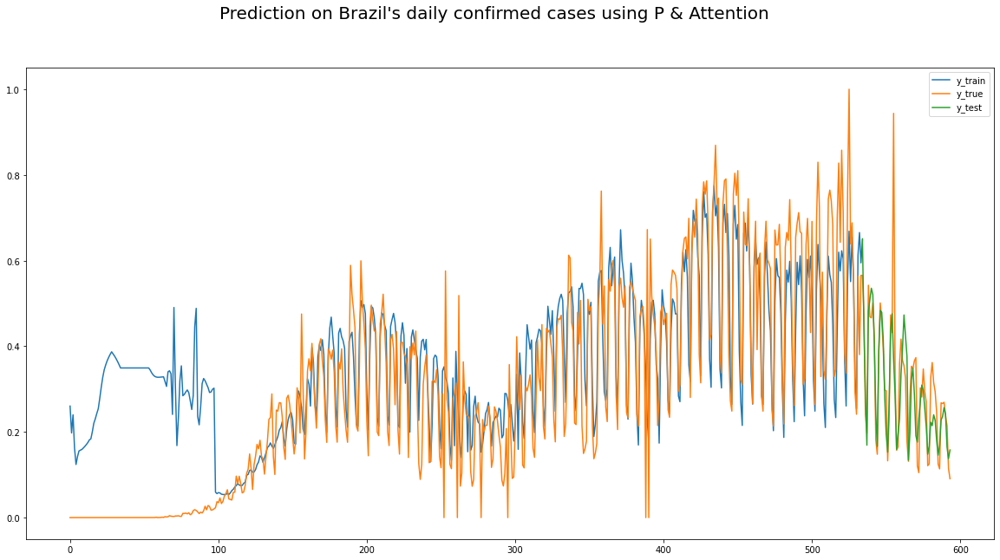

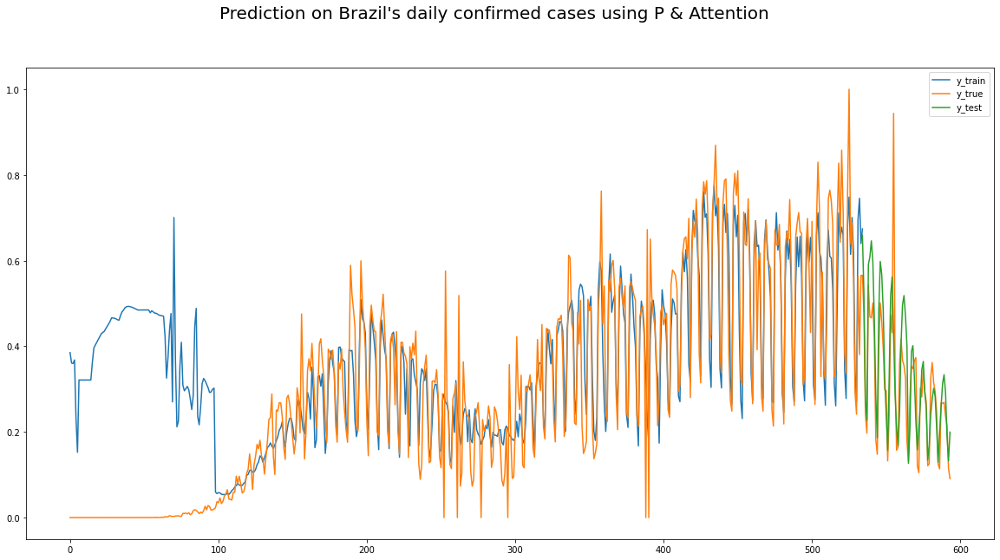

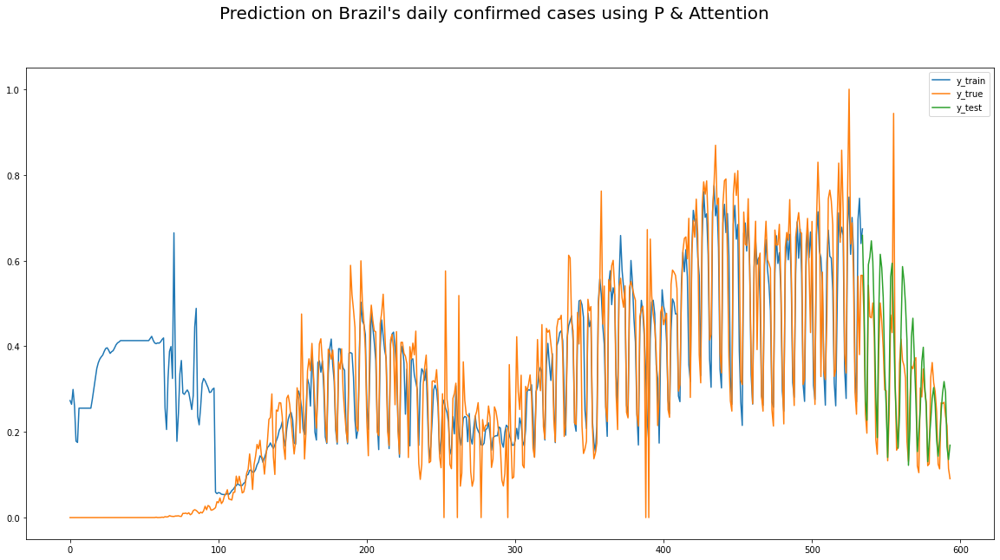

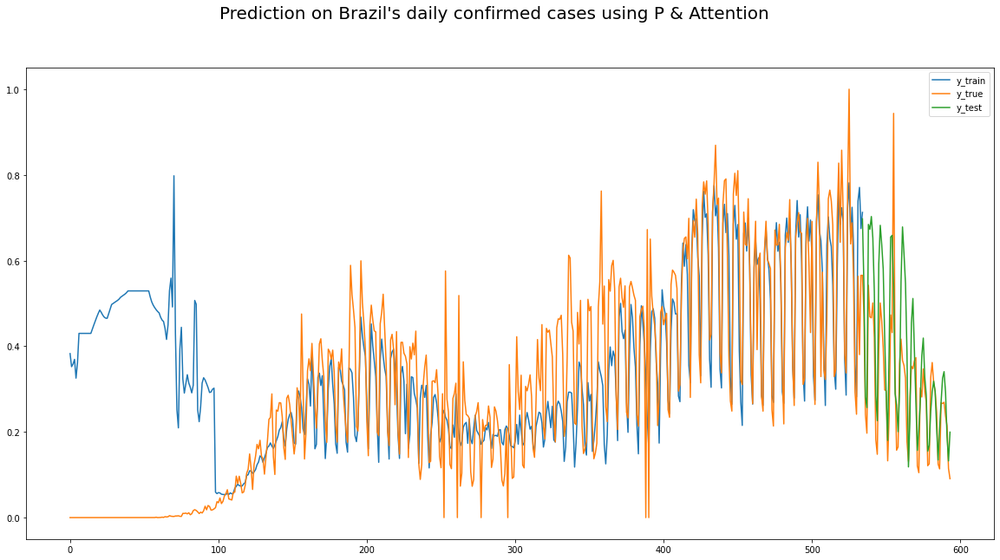

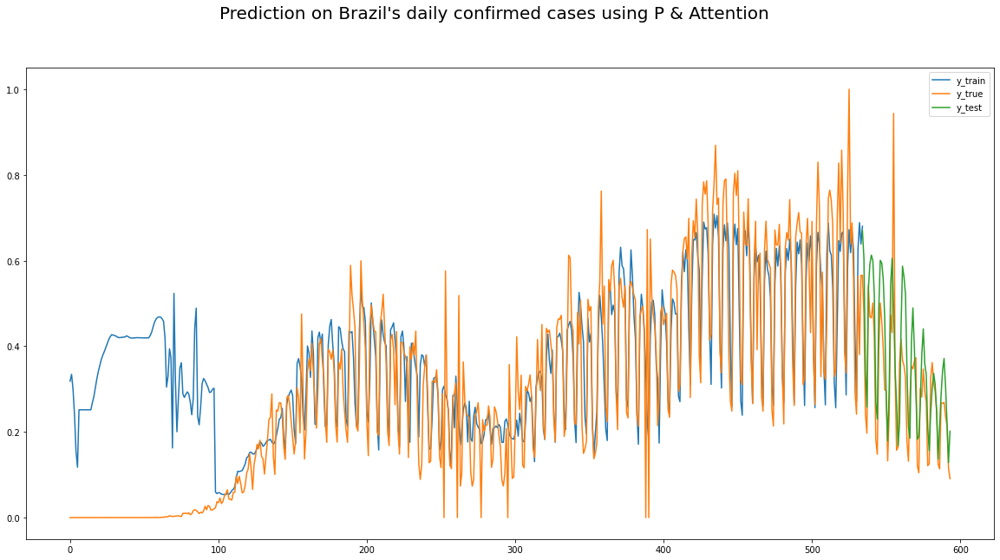

...

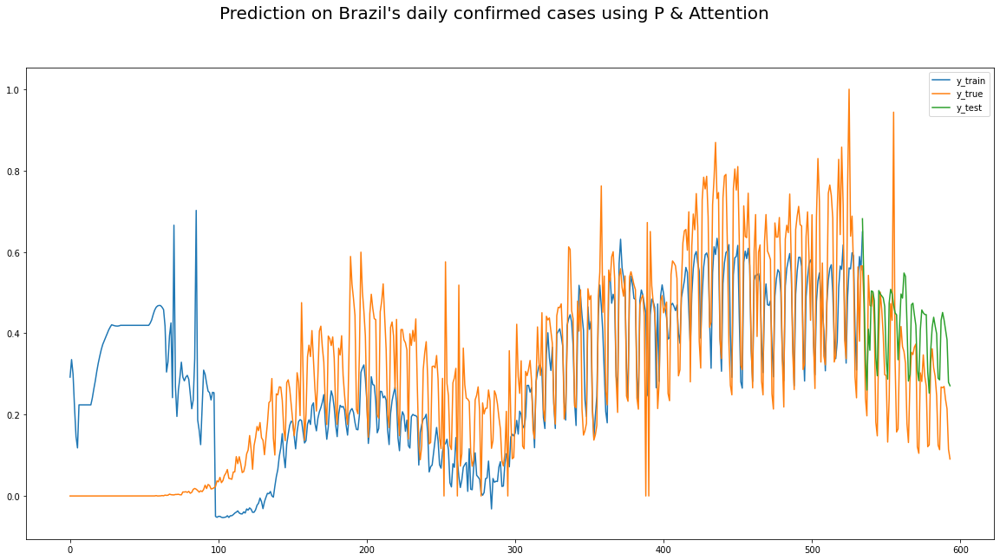

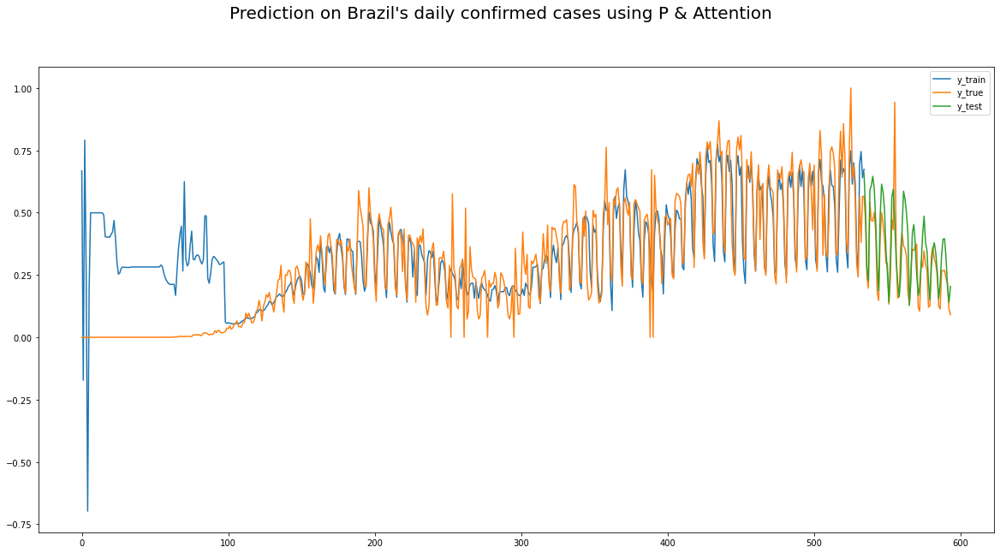

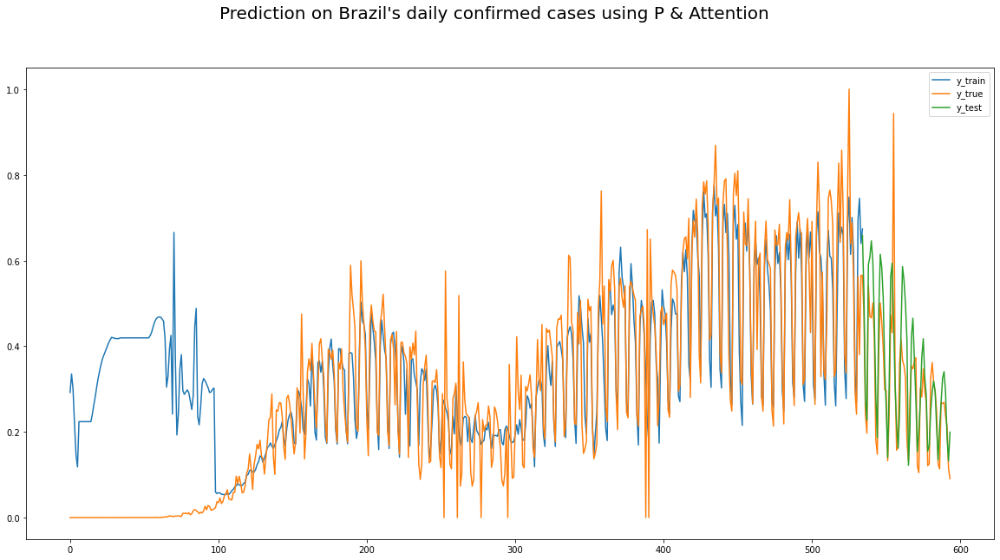

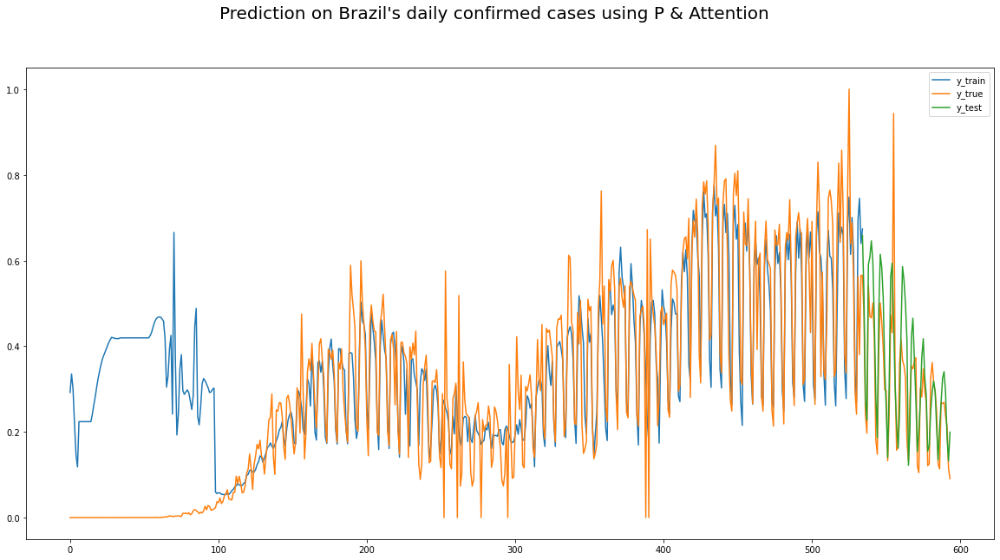

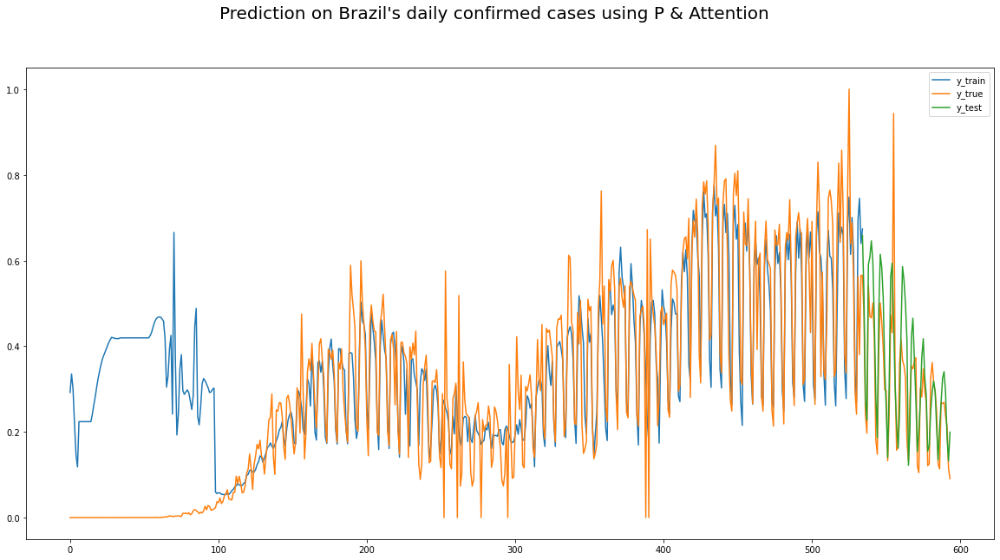

In [11]:
### Feature importance for the country
result = {}

for i in range(len(policy)):
    
    target = policy[i]
    x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days, swap_col=target)
    
    exp_train = compress_to_2d(best_model.predict(x_train))
    exp_test = compress_to_2d(best_model.predict(x_test))
    
    draw_graph(exp_train, exp_test, y_true_train, y_true_test, required_days, pred_days, country, features_used, x_train, algo)
    
    _loss = mse(y_true_train, exp_train).numpy()
    _val_loss = mse(y_true_test, exp_test).numpy()
    
    print("######", target, "#####")
    print("Changes in loss: {}".format(_loss-loss))
    print("Changes in Validation loss: {}".format(_val_loss-val_loss))
    
    result[target] = [loss, val_loss, _loss, _val_loss, _loss-loss, _val_loss-val_loss, _loss/loss, _val_loss/val_loss]

Changes = pd.DataFrame.from_dict(result, orient='index', columns=['Old loss', 'Old Validation loss', 'New Loss', 'New Validation Loss', 'Changes in loss', 
                                                                 'Changes in validation loss', 'Ratio of new-old loss', 'Ratio of new-old validation loss'])
Changes.to_csv(os.path.join(logdir, "{}/{}_feat_importance.csv".format(country, country)))

##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### Jan #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.009033795446157455
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.015578456223011017
Changes in Validation loss: -0.0008162688463926315
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.0015390850603580475
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.025992419570684433
Changes in Validation loss: -0.0006619393825531006
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.007259730249643326
Changes in Validation loss: 0.010733116418123245
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0027430690824985504
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.008664488792419434
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.0060056596994400024
Changes in Validation loss: 0.002780567854642868
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: -0.009730122983455658
Changes in Validation loss: 0.02385656163096428
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: -0.00410785898566246
Changes in Validation loss: 0.008214350789785385
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.003412935882806778
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.007296696305274963
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.026111338287591934
Changes in Validation loss: -0.006545668467879295
##### Reshape and MinMaxScale input #####
(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


###### H3_Contact tracing #####
Changes in loss: -0.01290096715092659
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: 9.5415860414505e-05
Changes in Validation loss: -0.0009828247129917145
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 6.446987390518188e-05
Changes in Validation loss: 0.000848798081278801
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.008471120148897171
Changes in Validation loss: -0.001808159053325653
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.0015910416841506958
Changes in Validation loss: 0.0006605647504329681
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0012938156723976135
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\plotting\_matplotlib\core.py:345: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = self.plt.figure(figsize=self.figsize)


###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(347, 14, 24) (347, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### Feb #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.00791836529970169
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.014738369733095169
Changes in Validation loss: 0.0005917977541685104
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.001407042145729065
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.022177141159772873
Changes in Validation loss: -0.0031288620084524155
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.00827489048242569
Changes in Validation loss: 0.0002164207398891449
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0017717592418193817
Changes in Validation loss: 0.0002171490341424942
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.007762279361486435
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(375, 14, 24) (375, 7, 1)

C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


 (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.0031417906284332275
Changes in Validation loss: 0.002367651090025902
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: -0.006547901779413223
Changes in Validation loss: 0.038145169615745544
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: -0.0031914599239826202
Changes in Validation loss: 0.023701539263129234
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0035742558538913727
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.006223227828741074
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.024083029478788376
Changes in Validation loss: -0.0032489635050296783
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.012006904929876328
Changes in Validation loss: 0.016168368980288506
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: 4.773586988449097e-05
Changes in Validation loss: -0.00011085532605648041
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 8.155778050422668e-05
Changes in Validation loss: 0.00731985829770565
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.007624536752700806
Changes in Validation loss: -0.0026403069496154785
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.003773968666791916
Changes in Validation loss: 0.012731688097119331
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0010599829256534576
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(375, 14, 24) (375, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### March #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.006812121719121933
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.012581206858158112
Changes in Validation loss: -0.00037250109016895294
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.0012666136026382446
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.01700291410088539
Changes in Validation loss: -0.0002453923225402832
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.007603693753480911
Changes in Validation loss: 0.002211958169937134
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0021810270845890045
Changes in Validation loss: 0.001366565003991127
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.007000606507062912
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.003047008067369461
Changes in Validation loss: 0.001670386642217636
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: -0.0020959563553333282
Changes in Validation loss: 0.04190724715590477
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: -0.0019232593476772308
Changes in Validation loss: 0.03195354342460632
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0025254227221012115
Changes in Validation loss: 0.0011482732370495796
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.0051051899790763855
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.022213008254766464
Changes in Validation loss: 0.0014130864292383194
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.009368326514959335
Changes in Validation loss: 0.04242623969912529
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: 1.3343989849090576e-05
Changes in Validation loss: 2.2573396563529968e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 0.0001705363392829895
Changes in Validation loss: -8.38274136185646e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.006634514778852463
Changes in Validation loss: -0.0018009794875979424
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.005576245486736298
Changes in Validation loss: 0.03081313520669937
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0009452439844608307
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(406, 14, 24) (406, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### April #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.005195204168558121
Changes in Validation loss: 0.00010186806321144104
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.010553505271673203
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.0010966882109642029
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.013765145093202591
Changes in Validation loss: -0.0002794777974486351
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.006840988993644714
Changes in Validation loss: 0.0042314110323786736
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0017003417015075684
Changes in Validation loss: 0.0008922824636101723
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.006668154150247574
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.0029904507100582123
Changes in Validation loss: 4.9872323870658875e-06
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: 0.0005703270435333252
Changes in Validation loss: 0.014995436184108257
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.0001692846417427063
Changes in Validation loss: 0.02132207155227661
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0010685250163078308
Changes in Validation loss: 0.0001628762111067772
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.004801858216524124
Changes in Validation loss: -8.402764797210693e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.020663131028413773
Changes in Validation loss: -0.0026622721925377846
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.006021285429596901
Changes in Validation loss: 0.031110119074583054
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: 8.21426510810852e-05
Changes in Validation loss: -1.5144236385822296e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: -9.470805525779724e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.006519787013530731
Changes in Validation loss: -0.0019632987678050995
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.008858498185873032
Changes in Validation loss: 0.018413878977298737
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.000739462673664093
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(436, 14, 24) (436, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### May #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.005148887634277344
Changes in Validation loss: 0.010132982395589352
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.008552305400371552
Changes in Validation loss: 0.0017488747835159302
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.0011156946420669556
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.011946920305490494
Changes in Validation loss: -0.0025751995854079723
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.0062412843108177185
Changes in Validation loss: 0.0031508496031165123
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.001676950603723526
Changes in Validation loss: -9.661167860031128e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.006563881412148476
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.0029911473393440247
Changes in Validation loss: -3.266334533691406e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: 0.0005587860941886902
Changes in Validation loss: 0.013827885501086712
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.0009146593511104584
Changes in Validation loss: 0.020864054560661316
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0015827640891075134
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.004569977521896362
Changes in Validation loss: -0.0006804363802075386
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.018629584461450577
Changes in Validation loss: -0.0029304688796401024
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.005295420065522194
Changes in Validation loss: 0.024893417954444885
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: 8.318200707435608e-05
Changes in Validation loss: -5.857087671756744e-06
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 4.0240585803985596e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.006611969321966171
Changes in Validation loss: -0.0010502906516194344
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.008878182619810104
Changes in Validation loss: 0.014643493108451366
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0007704459130764008
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(467, 14, 24) (467, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### June #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.005092056468129158
Changes in Validation loss: 0.006286324933171272
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.006144864484667778
Changes in Validation loss: -3.77800315618515e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.001040702685713768
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.01284118928015232
Changes in Validation loss: -0.00037608295679092407
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.00563848577439785
Changes in Validation loss: 0.0017911624163389206
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.001576235517859459
Changes in Validation loss: -9.541399776935577e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.00604819692671299
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.002745429053902626
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: 0.0013939831405878067
Changes in Validation loss: 0.010944919660687447
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.0008755717426538467
Changes in Validation loss: 0.0201237965375185
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0018952302634716034
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.004726788029074669
Changes in Validation loss: 0.000418955460190773
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.016526104882359505
Changes in Validation loss: 0.0012058056890964508
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.003956956788897514
Changes in Validation loss: 0.026567282155156136
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: 6.406567990779877e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 0.00012113898992538452
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.005735613405704498
Changes in Validation loss: 0.00027880072593688965
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.008009621873497963
Changes in Validation loss: 0.016202574595808983
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0007677581161260605
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(497, 14, 24) (497, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### July #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.004791963845491409
Changes in Validation loss: -0.005166707560420036
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.005986237898468971
Changes in Validation loss: -0.0012081339955329895
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.0008946191519498825
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.01340082474052906
Changes in Validation loss: 0.0074616167694330215
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.0023978110402822495
Changes in Validation loss: 0.0016191080212593079
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0015434343367815018
Changes in Validation loss: 0.00016666576266288757
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.005654916167259216
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.002532443031668663
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: 0.0022502709180116653
Changes in Validation loss: -0.0046136025339365005
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.0050524380058050156
Changes in Validation loss: -0.0035261940211057663
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0007703397423028946
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.0049079712480306625
Changes in Validation loss: 5.501694977283478e-05
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.013081295415759087
Changes in Validation loss: 0.019801540300250053
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.0020035281777381897
Changes in Validation loss: -0.0013128463178873062
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: -2.9109418392181396e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 6.0986727476119995e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.0053190551698207855
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.009354108944535255
Changes in Validation loss: 0.003027014434337616
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0007910560816526413
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(528, 14, 24) (528, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### August #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.0048521533608436584
Changes in Validation loss: -0.0017478903755545616
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.006044045090675354
Changes in Validation loss: -0.0015442785806953907
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.0010178349912166595
Changes in Validation loss: -0.00020422134548425674
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.015058878809213638
Changes in Validation loss: 0.0010633505880832672
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.0003796461969614029
Changes in Validation loss: -0.00034804828464984894
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0014976952224969864
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.005393890663981438
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.002324361354112625
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: 0.002627737820148468
Changes in Validation loss: -0.002231219317764044
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.006086312234401703
Changes in Validation loss: -0.0037626074627041817
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0003151930868625641
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.0052810050547122955
Changes in Validation loss: -0.0005838591605424881
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.01261591911315918
Changes in Validation loss: 0.011557859368622303
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.001780875027179718
Changes in Validation loss: -0.001139557920396328
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: -0.0006084907799959183
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 2.4165958166122437e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.00455918163061142
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.009297404438257217
Changes in Validation loss: 0.012376920320093632
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0006889384239912033
Changes in Validation loss: 0.002026061527431011
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####
(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### Sept #####
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C1_School closing #####
Changes in loss: -0.0048521533608436584
Changes in Validation loss: -0.0017478903755545616
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C2_Workplace closing #####
Changes in loss: 0.006044045090675354
Changes in Validation loss: -0.0015442785806953907
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C3_Cancel public events #####
Changes in loss: -0.0010178349912166595
Changes in Validation loss: -0.00020422134548425674
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C4_Restrictions on gatherings #####
Changes in loss: 0.015058878809213638
Changes in Validation loss: 0.0010633505880832672
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C5_Close public transport #####
Changes in loss: 0.0003796461969614029
Changes in Validation loss: -0.00034804828464984894
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C6_Stay at home requirements #####
Changes in loss: 0.0014976952224969864
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C7_Restrictions on internal movement #####
Changes in loss: -0.005393890663981438
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### C8_International travel controls #####
Changes in loss: 0.002324361354112625
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E1_Income support #####
Changes in loss: 0.002627737820148468
Changes in Validation loss: -0.002231219317764044
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E2_Debt/contract relief #####
Changes in loss: 0.006086312234401703
Changes in Validation loss: -0.0037626074627041817
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E3_Fiscal measures #####
Changes in loss: -0.0003151930868625641
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### E4_International support #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H1_Public information campaigns #####
Changes in loss: 0.0052810050547122955
Changes in Validation loss: -0.0005838591605424881
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H2_Testing policy #####
Changes in loss: 0.01261591911315918
Changes in Validation loss: 0.011557859368622303
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H3_Contact tracing #####
Changes in loss: -0.001780875027179718
Changes in Validation loss: -0.001139557920396328
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H4_Emergency investment in healthcare #####
Changes in loss: -0.0006084907799959183
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H5_Investment in vaccines #####
Changes in loss: 2.4165958166122437e-05
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H6_Facial Coverings #####
Changes in loss: -0.00455918163061142
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H7_Vaccination policy #####
Changes in loss: 0.009297404438257217
Changes in Validation loss: 0.012376920320093632
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### H8_Protection of elderly people #####
Changes in loss: -0.0006889384239912033
Changes in Validation loss: 0.002026061527431011
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### V1_Vaccine Prioritisation (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### V2_Vaccine Availability (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0
##### Reshape and MinMaxScale input #####


C:\Users\wasin\Tensorflow\venv\lib\site-packages\pandas\core\indexing.py:1951: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[selected_item_labels] = value


(558, 14, 24) (558, 7, 1) (30, 14, 24) (30, 7, 1)
###### V3_Vaccine Financial Support (summary) #####
Changes in loss: 0.0
Changes in Validation loss: 0.0


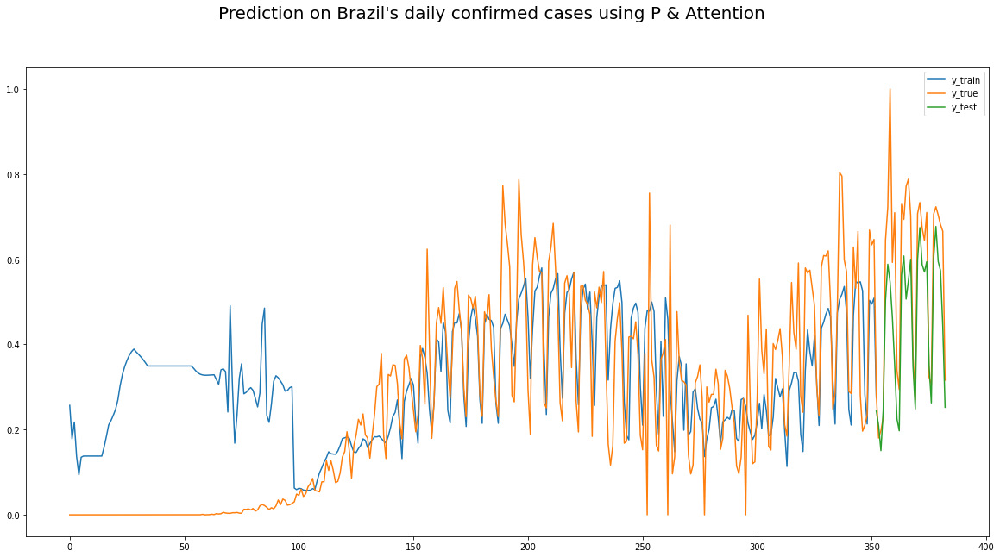

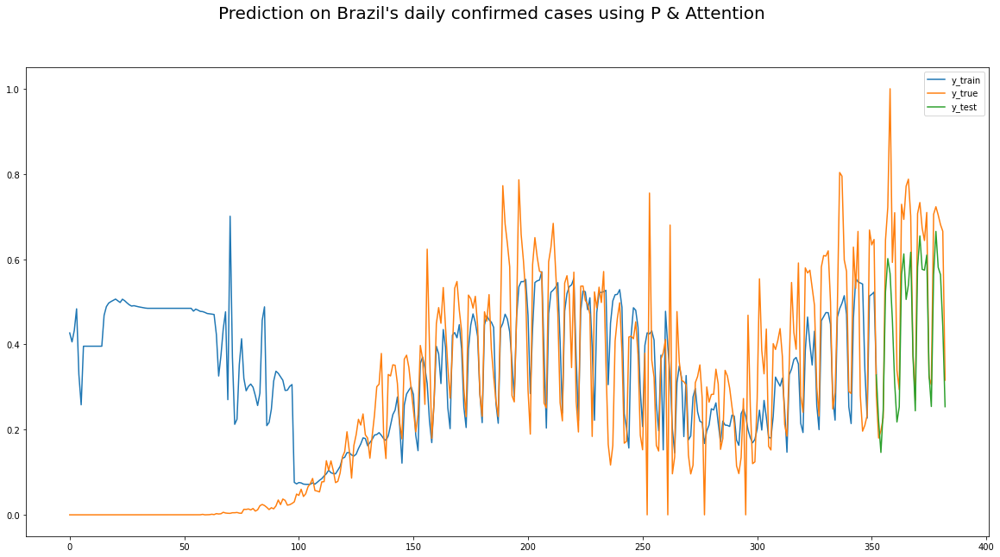

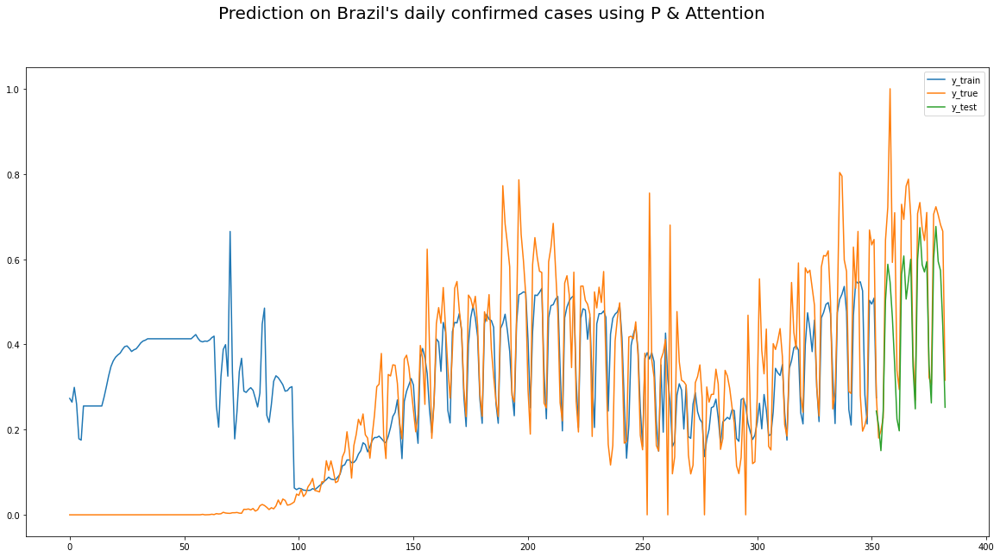

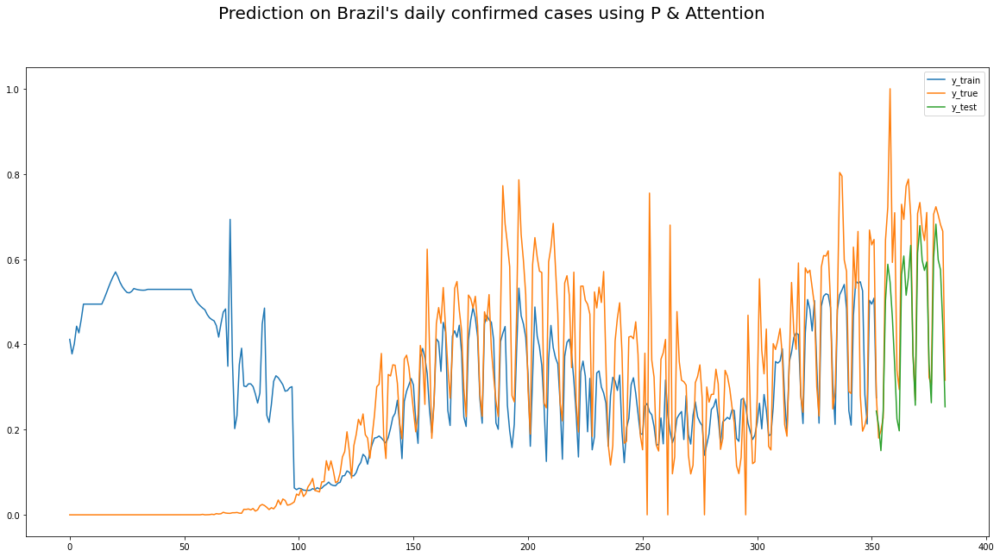

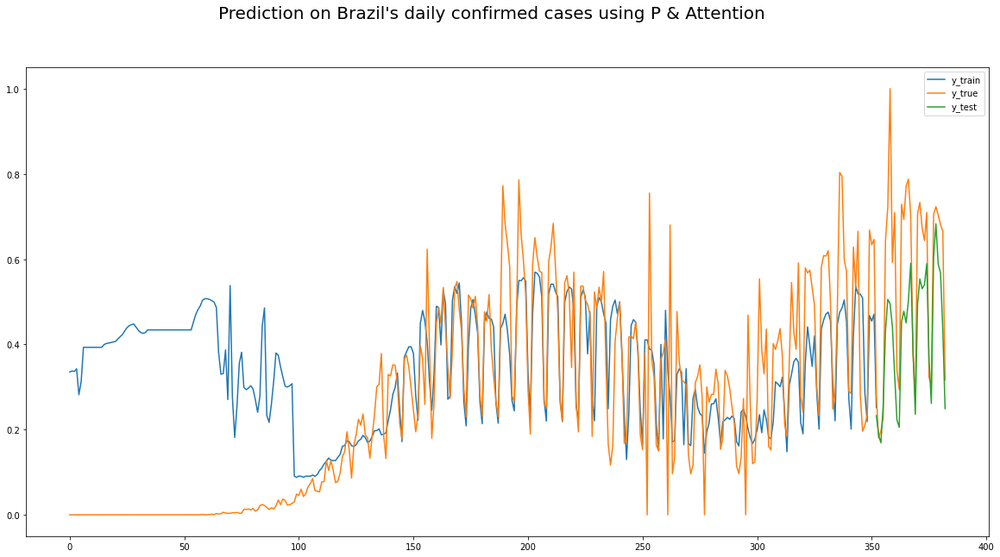

...

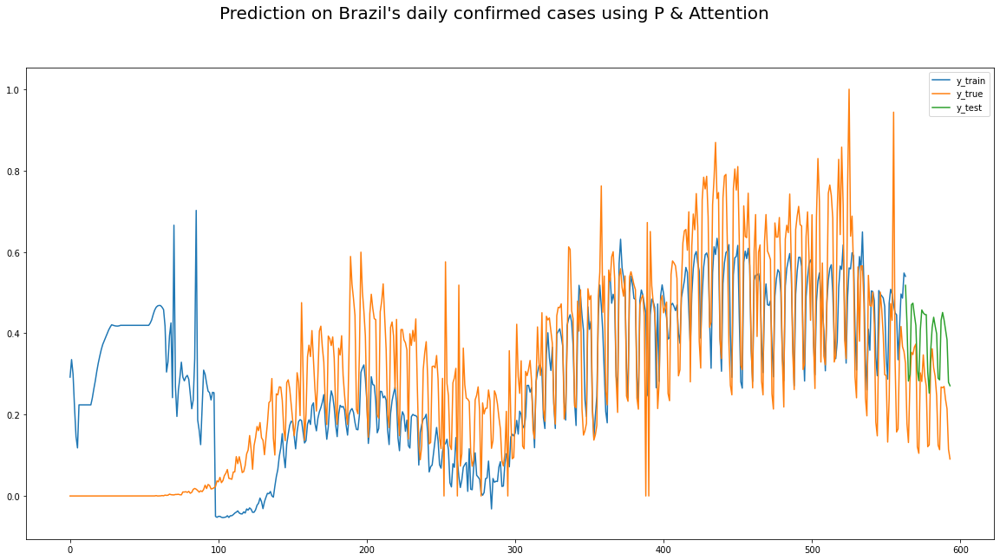

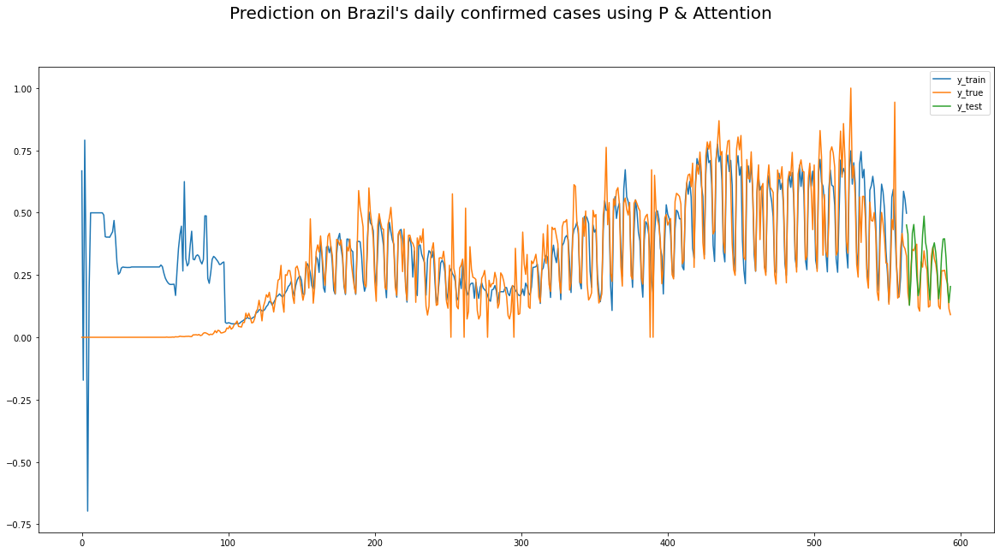

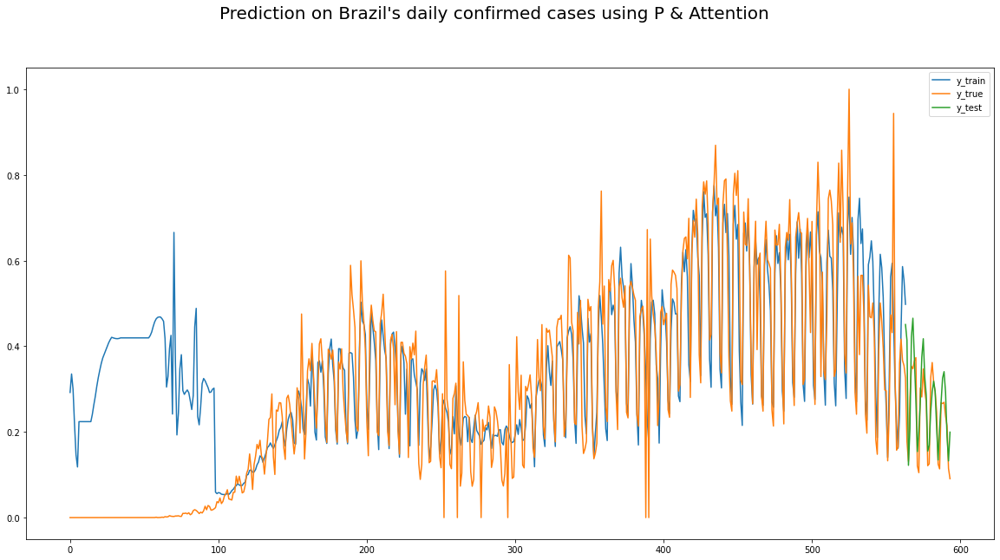

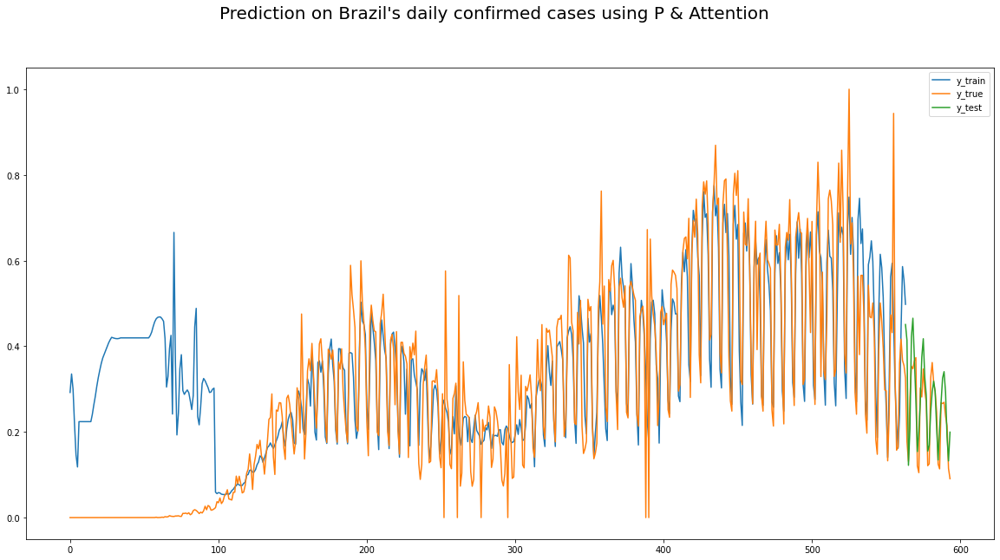

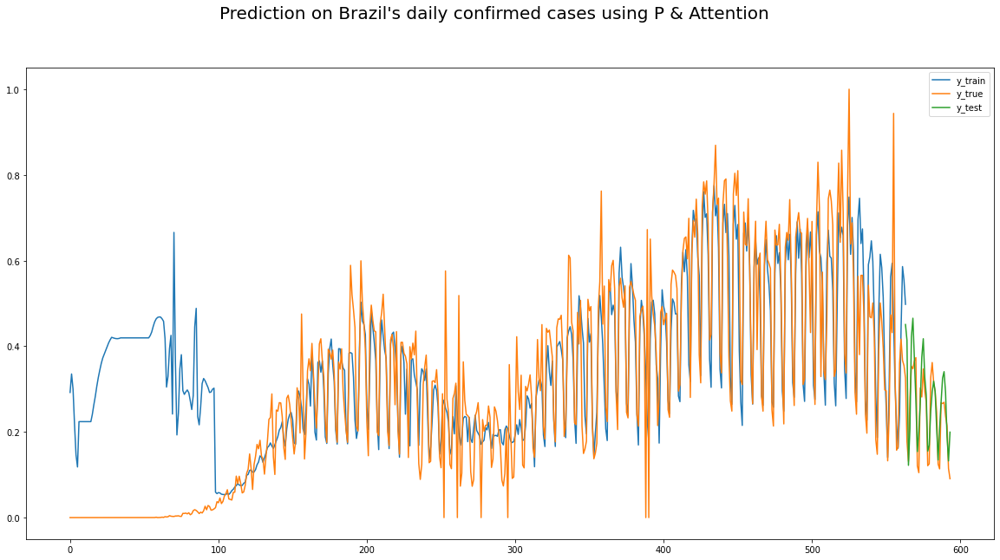

In [12]:
### Feature importance for the country each month
months = ['Jan', 'Feb', 'March', 'April', 'May', 'June', 'July', 'August', 'Sept']

for i in range(len(months)):

    tmp = df[pd.to_datetime(df.index, dayfirst=True) < dt(2021, i+2, 1)]
    
    x_train, x_test, y_train, y_test = data_handling(tmp, features, required_days, pred_days, test_size=30)
    y_pred_train = compress_to_2d(best_model.predict(x_train))
    y_pred_test = compress_to_2d(best_model.predict(x_test))
    y_true_train = compress_to_2d(y_train)
    y_true_test = compress_to_2d(y_test)

    mse = tf.keras.losses.MeanSquaredError()
    loss = mse(y_true_train, y_pred_train).numpy()
    val_loss = mse(y_true_test, y_pred_test).numpy()
    
    result2 = {}
    
    print("######", months[i], "#####")

    for j in range(len(policy)):
        
        target = policy[j]
        xx_train, xx_test, yy_train, yy_test = data_handling(tmp, features, required_days, pred_days, swap_col=target, test_size=30)
    
        exp_train = compress_to_2d(best_model.predict(xx_train))
        exp_test = compress_to_2d(best_model.predict(xx_test))
    
        draw_graph(exp_train, exp_test, y_true_train, y_true_test, required_days, pred_days, country, features_used, xx_train, algo)

        _loss = mse(y_true_train, exp_train).numpy()
        _val_loss = mse(y_true_test, exp_test).numpy()

        print("######", target, "#####")
        print("Changes in loss: {}".format(_loss-loss))
        print("Changes in Validation loss: {}".format(_val_loss-val_loss))

        result2[target] = [loss, val_loss, _loss, _val_loss, _loss-loss, _val_loss-val_loss, _loss/loss, _val_loss/val_loss]

    Changes = pd.DataFrame.from_dict(result2, orient='index', columns=['Old loss', 'Old Validation loss', 'New Loss', 'New Validation Loss', 'Changes in loss', 
                                                                 'Changes in validation loss', 'Ratio of new-old loss', 'Ratio of new-old validation loss'])
    Changes.to_csv(os.path.join(logdir, "{}/{}_feat_importance_{}.csv".format(country, country, months[i])))

### Feature importance for the country
result2 = {}

for i in range(len(policy)):
    
    target = policy[i]
    x_train, x_test, y_train, y_test = data_handling(df, features, required_days, pred_days, swap_col=target)
        
    if algo == 'Attention':
        model = keras.Model.from_config(config)
    else:
        model = keras.Sequential.from_config(config)

    model.compile(optimizer=opt, loss=rmse)
    model.summary()
    
    kf = KFold()
    for train_index, test_index in kf.split(x_train):
        xx_train, xx_test = x_train[train_index], x_train[test_index]
        yy_train, yy_test = y_train[train_index], y_train[test_index]
        
        history = model.fit(xx_train, yy_train, shuffle=True,
                 validation_data=(xx_test, yy_test),
                 epochs=1000,
                 callbacks=[early_stopping, reduce_lr],
                 verbose=0)
    
    exp_train = compress_to_2d(model.predict(x_train))
    exp_test = compress_to_2d(model.predict(x_test))

    _loss = mse(y_true_train, exp_train).numpy()
    _val_loss = mse(y_true_test, exp_test).numpy()
    
    print("######", target, "#####")
    print("Changes in loss: {}".format(_loss-loss))
    print("Changes in Validation loss: {}".format(_val_loss-val_loss))
    
    result2[target] = [loss, val_loss, _loss, _val_loss, _loss-loss, _val_loss-val_loss, _loss/loss, _val_loss/val_loss]

Changes = pd.DataFrame.from_dict(result2, orient='index', columns=['Old loss', 'Old Validation loss', 'New Loss', 'New Validation Loss', 'Changes in loss', 
                                                                 'Changes in validation loss', 'Ratio of new-old loss', 'Ratio of new-old validation loss'])
Changes.to_csv(os.path.join(logdir, "{}_feat_importance.csv".format(country)))